This tutorial processes C. elegans embryogenesis single cell data published by [Packer & Zhu et al., 2019](https://doi.org/10.1126/science.aax1971). Data can be downloaded from https://zenodo.org/records/15236812.

### Load package and data

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import concord as ccd
import scanpy as sc
import torch
import warnings
from pathlib import Path
import time
warnings.filterwarnings('ignore')

data_dir = Path('../data/celegans_data/') # Replace with your data directory
data_path = data_dir / "celegans_global_adata.h5ad"

In [3]:
proj_name = "concord_celegans"
save_dir = f"../save/{proj_name}-{time.strftime('%b%d')}/" # Replace with your save directory if needed
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu') # Replace with your device, for example, 'mps' for Apple silicon
file_suffix = f"{time.strftime('%b%d-%H%M')}" # Replace with your file suffix if needed
seed = 0

In [4]:
adata = sc.read(data_path, backed='r') # Read the AnnData object in read-only mode
#adata.layers["counts"] = adata.X.copy() # Store raw counts in a layer, because adata.X can be modified
#adata = adata[adata.obs['to.filter'] == 'FALSE'] # Only keep cells that pass quality filter

In [5]:
# sc.pp.normalize_total(adata, target_sum=1e4) # Normalize to 10,000 reads per cell
# sc.pp.log1p(adata) # Log transform the data

### Run Concord

In [8]:
feature_list = ccd.ul.select_features(adata, n_top_features=10000, flavor='seurat_v3') # Loosely select features based on Seurat v3 method (so that enough information is preserved)

concord_args = {
        'adata': adata,
        'input_feature': feature_list,
        'batch_size':64, # Batch size for training, adjust as needed
        'latent_dim': 300, # Latent dimension size, adjust as needed
        'encoder_dims':[1000], # Encoder dimensions, recommended to be larger than latent_dim
        'use_decoder': False, # Whether to use a decoder, set to True if you want to use the decoder
        'decoder_dims':[1000], # Decoder dimensions, ignored if use_decoder is False
        'augmentation_mask_prob': 0.3, # Probability of masking features, recommended to be between 0.2 and 0.5
        'clr_temperature': 0.3, # Temperature for contrastive loss, recommended to be between 0.1 and 0.5
        'p_intra_knn': 0.3, # Probability of intra-neighborhood sampling, must be less than 0.5
        'sampler_knn': 300, # Size of neighbohood for intra-neighborhood sampling
        'p_intra_domain': .95, # Enrichment probability for intra-domain sampling, recommended to be between 0.85 and 1.0, note the lower the value, the more dataset-specific information (may contain batch effects) is preserved
        'n_epochs': 3, # Number of epochs for training, adjust as needed
        'domain_key': 'batch', # Key in adata.obs for batch labels
        'verbose': True, # Verbosity level, set to True for more detailed output
        'copy_adata': False, # Whether to modify adata in place, if not you need to copy the obsm out of ccd.adata
        'chunked': True, # Whether to use chunked training, set to True for large datasets
        'normalize_total': True, # Whether to normalize total counts
        'log1p': True, # Whether to log transform the data
        'seed': seed, # random seed for reproducibility
        'device': device, # Device for training, can be 'cpu', 'cuda', or 'mps'
        'save_dir': save_dir # Directory to save the model and results
    }

In [10]:
output_key = 'Concord'
cur_ccd = ccd.Concord(**concord_args)
cur_ccd.encode_adata(output_key=output_key) # Result saved to ccd.adata.obsm[output_key]
adata.obsm = cur_ccd.adata.obsm # If not inplace, copy the obsm out of ccd.adata

Concord - INFO - Running CONCORD on a backed AnnData object. 
Concord - WARNING - Input AnnData object is in backed mode. Preprocessing will not modify the file on disk.


Concord - INFO - Column 'batch' is already of type: category
Concord - INFO - Unused levels dropped for column 'batch'.
Concord - INFO - Encoder input dim: 10000
Concord - INFO - Model loaded to device: cpu
Concord - INFO - Total number of parameters: 10303956
Concord - INFO - Using chunked loading with chunk size: 10000
Concord - INFO - Starting epoch 1/3
Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 1/10 for epoch 1
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 0 Training: 100%|██████████| 154/154 [00:03<00:00, 45.19it/s, loss=2.7] 

Concord - INFO - Epoch   0 | Train Loss: 3.12, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.12, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 2/10 for epoch 1
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 0 Training: 100%|██████████| 154/154 [00:03<00:00, 46.08it/s, loss=2.66]

Concord - INFO - Epoch   0 | Train Loss: 2.68, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.68, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 3/10 for epoch 1
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 0 Training: 100%|██████████| 152/152 [00:03<00:00, 45.63it/s, loss=2.61]

Concord - INFO - Epoch   0 | Train Loss: 2.59, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.59, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 4/10 for epoch 1
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 0 Training: 100%|██████████| 152/152 [00:03<00:00, 46.13it/s, loss=2.54]

Concord - INFO - Epoch   0 | Train Loss: 2.56, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.56, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 5/10 for epoch 1
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 0 Training: 100%|██████████| 152/152 [00:03<00:00, 45.48it/s, loss=2.62]

Concord - INFO - Epoch   0 | Train Loss: 2.54, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.54, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 6/10 for epoch 1
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 0 Training: 100%|██████████| 153/153 [00:03<00:00, 44.18it/s, loss=2.55]

Concord - INFO - Epoch   0 | Train Loss: 2.50, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.50, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 7/10 for epoch 1
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 0 Training: 100%|██████████| 152/152 [00:03<00:00, 41.22it/s, loss=2.41]

Concord - INFO - Epoch   0 | Train Loss: 2.48, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.48, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 8/10 for epoch 1
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 0 Training: 100%|██████████| 152/152 [00:03<00:00, 43.31it/s, loss=2.46]

Concord - INFO - Epoch   0 | Train Loss: 2.47, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.47, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 9/10 for epoch 1
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 0 Training: 100%|██████████| 153/153 [00:03<00:00, 45.70it/s, loss=2.47]

Concord - INFO - Epoch   0 | Train Loss: 2.48, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.48, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 10/10 for epoch 1
Concord - INFO - Number of samples in train_dataloader: 6084


Epoch 0 Training: 100%|██████████| 91/91 [00:02<00:00, 44.62it/s, loss=2.33]

Concord - INFO - Epoch   0 | Train Loss: 2.42, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.42, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 2/3


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 1/10 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 1 Training: 100%|██████████| 154/154 [00:03<00:00, 45.17it/s, loss=2.43]

Concord - INFO - Epoch   1 | Train Loss: 2.43, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.43, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 2/10 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 1 Training: 100%|██████████| 153/153 [00:03<00:00, 45.92it/s, loss=2.37]

Concord - INFO - Epoch   1 | Train Loss: 2.43, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.43, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 3/10 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 1 Training: 100%|██████████| 152/152 [00:03<00:00, 45.67it/s, loss=2.26]

Concord - INFO - Epoch   1 | Train Loss: 2.42, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.42, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 4/10 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 1 Training: 100%|██████████| 152/152 [00:03<00:00, 41.87it/s, loss=2.41]

Concord - INFO - Epoch   1 | Train Loss: 2.41, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.41, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 5/10 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 1 Training: 100%|██████████| 153/153 [00:03<00:00, 44.83it/s, loss=2.61]

Concord - INFO - Epoch   1 | Train Loss: 2.40, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.40, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 6/10 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 1 Training: 100%|██████████| 153/153 [00:03<00:00, 46.11it/s, loss=2.32]

Concord - INFO - Epoch   1 | Train Loss: 2.40, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.40, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 7/10 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 1 Training: 100%|██████████| 153/153 [00:03<00:00, 45.43it/s, loss=2.37]

Concord - INFO - Epoch   1 | Train Loss: 2.40, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.40, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 8/10 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 1 Training: 100%|██████████| 153/153 [00:03<00:00, 45.24it/s, loss=2.55]

Concord - INFO - Epoch   1 | Train Loss: 2.40, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.40, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 9/10 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 1 Training: 100%|██████████| 154/154 [00:03<00:00, 45.51it/s, loss=2.41]

Concord - INFO - Epoch   1 | Train Loss: 2.39, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.39, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 10/10 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 6084


Epoch 1 Training: 100%|██████████| 91/91 [00:02<00:00, 45.15it/s, loss=2.23]

Concord - INFO - Epoch   1 | Train Loss: 2.36, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.36, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 3/3


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 1/10 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 2 Training: 100%|██████████| 153/153 [00:03<00:00, 45.26it/s, loss=2.37]

Concord - INFO - Epoch   2 | Train Loss: 2.37, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.37, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 2/10 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 2 Training: 100%|██████████| 152/152 [00:03<00:00, 44.92it/s, loss=2.26]

Concord - INFO - Epoch   2 | Train Loss: 2.36, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.36, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 3/10 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 2 Training: 100%|██████████| 153/153 [00:03<00:00, 44.78it/s, loss=2.23]

Concord - INFO - Epoch   2 | Train Loss: 2.36, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.36, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 4/10 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 2 Training: 100%|██████████| 152/152 [00:03<00:00, 44.38it/s, loss=2.42]

Concord - INFO - Epoch   2 | Train Loss: 2.36, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.36, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 5/10 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 2 Training: 100%|██████████| 153/153 [00:03<00:00, 45.56it/s, loss=2.32]

Concord - INFO - Epoch   2 | Train Loss: 2.37, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.37, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 6/10 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 2 Training: 100%|██████████| 152/152 [00:03<00:00, 45.08it/s, loss=2.34]

Concord - INFO - Epoch   2 | Train Loss: 2.36, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.36, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 7/10 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 2 Training: 100%|██████████| 154/154 [00:03<00:00, 43.01it/s, loss=2.34]

Concord - INFO - Epoch   2 | Train Loss: 2.36, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.36, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 8/10 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 2 Training: 100%|██████████| 153/153 [00:03<00:00, 45.20it/s, loss=2.27]

Concord - INFO - Epoch   2 | Train Loss: 2.35, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.35, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 9/10 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 10000


Epoch 2 Training: 100%|██████████| 153/153 [00:03<00:00, 45.32it/s, loss=2.31]

Concord - INFO - Epoch   2 | Train Loss: 2.36, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.36, IMPORTANCE: 0.00


Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.


Concord - INFO - Processing chunk 10/10 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 6084


Epoch 2 Training: 100%|██████████| 93/93 [00:02<00:00, 44.80it/s, loss=2.28]

Concord - INFO - Epoch   2 | Train Loss: 2.31, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.31, IMPORTANCE: 0.00


Concord - INFO - Model saved to ../save/concord_celegans-Jun15/final_model_Jun15-2014.pt
Concord - INFO - Final model saved at: ../save/concord_celegans-Jun15/final_model_Jun15-2014.pt; Configuration saved at: ../save/concord_celegans-Jun15/config_Jun15-2014.json.
Concord - INFO - Using chunked loading with chunk size: 10000
Concord - INFO - Predicting for chunk 1/10
Concord - INFO - Predicting for chunk 2/10
Concord - INFO - Predicting for chunk 3/10
Concord - INFO - Predicting for chunk 4/10
Concord - INFO - Predicting for chunk 5/10
Concord - INFO - Predicting for chunk 6/10
Concord - INFO - Predicting for chunk 7/10
Concord - INFO - Predicting for chunk 8/10
Concord - INFO - Predicting for chunk 9/10
Concord - INFO - Predicting for chunk 10/10
Concord - INFO - Predictions added to AnnData object with base key 'Concord'.


### Visualization

We recommend using UMAP to visualize the CONCORD latent space:

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']


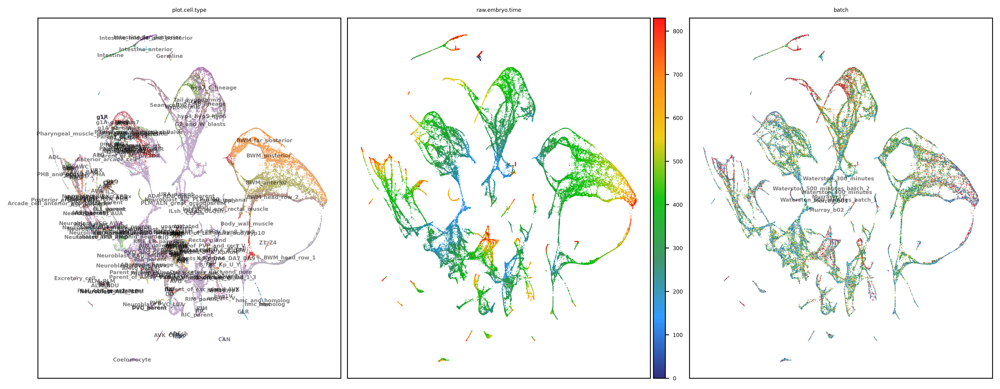

In [12]:
basis = 'Concord'
ccd.ul.run_umap(adata, source_key=basis, result_key=f'{basis}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = basis + '_UMAP'
show_cols = ['plot.cell.type', 'raw.embryo.time', "batch"]
pal = {'plot.cell.type': 'tab20', 'raw.embryo.time': 'BlueGreenRed', "batch": 'tab20'}
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,5), dpi=600, ncols=3, font_size=5, point_size=2, legend_loc='on data', 
    pal = pal,
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [ ]:
ccd.ul.run_umap(adata, source_key=basis, result_key=f'{basis}_UMAP_3D', n_components=3, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
import plotly.io as pio
pio.renderers.default = 'notebook'
for col in show_cols:
    show_basis = f'{basis}_UMAP_3D'
    ccd.pl.plot_embedding_3d(
            adata, basis=show_basis, color_by=col,
            pal = pal[col],
            save_path=save_dir / f'{show_basis}_{col}_{file_suffix}.html',
            point_size=1, opacity=0.8, width=1500, height=1000
        )

In [37]:
adata.write_h5ad(data_dir / f"{proj_name}_{file_suffix}.h5ad") # Save the adata object with the encoded embeddings
print(f"Saved adata to {data_dir / f'{proj_name}_{file_suffix}.h5ad'}")

Saved adata to ../data/celegans_data/concord_celegans_Apr17-1140.h5ad
